<a href="https://colab.research.google.com/github/absternator/Dog-breed-classification-TransferLearning/blob/main/Dog_breed_identification_CNN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Multi-class Dog breed Classification 🐶
This notebook builds a multi-class image classification model using Tensforflow and Tensorflow Hub. 

## 1. Problem 
Identify the breed of a dog given an image of a dog.

> If i take a photo of a dog, i want to know what breed of dog it is?
## 2. Data
The data is from the kaggle dog [breed identification competition](https://www.kaggle.com/c/dog-breed-identification/data)
## 3. Evaluation 
The evaluation is a submission file that containst the probabilites for each dog breed for each test image.

Submissions are evaluated on Multi Class Log Loss between the predicted probability and the observed targe
## 4. Features 
- All data is in images 
- There are 120 breeds of dogs(120 classes)
- There are 10,000+ images in training and test sets. Train sets have labels, whilst test set does not. This is because we want to predict the test set. 

In [ ]:
# imports 
import tensorflow as tf
# check tensorflow version 
print("TF version:",tf.__version__)

TF version: 2.4.0


In [ ]:
# unzip data file 
!unzip "/content/drive/MyDrive/dog-breed-identification.zip"


Streaming output truncated to the last 5000 lines.
  inflating: train/83bc62b0fffa99a9c94ba0b67a5f7395.jpg  
  inflating: train/83bcff6b55ee179a7c123fa6103c377a.jpg  
  inflating: train/83be6d622ab74a5e7e08b53eb8fd566a.jpg  
  inflating: train/83c2d7419b0429b9fe953bc1b6cddbec.jpg  
  inflating: train/83cf7d7cd2a759a93e2ffd95bea9c6fb.jpg  
  inflating: train/83d405858f0931722ef21e8ac0adee4d.jpg  
  inflating: train/83d4125a4c3c7dc5956563276cb1cd74.jpg  
  inflating: train/83f0bb565b2186dbcc6a9d009cb26ff2.jpg  
  inflating: train/83fad0718581a696132c96c166472627.jpg  
  inflating: train/83fbbcc9a612e3f712b1ba199da61f20.jpg  
  inflating: train/8403d8936430c2f05ab7d74d23c2c0cb.jpg  
  inflating: train/8406d837b2d7fac1c3cd621abb4c4f9e.jpg  
  inflating: train/840b67d26e5e43f8eb6430f62d4ba1ac.jpg  
  inflating: train/840db91ba4600148f3dcb06ec419b421.jpg  
  inflating: train/840dbad5a691c22611d85b2488bf4cbb.jpg  
  inflating: train/8410ced9ebc1759a7ebce5c42bfb5222.jpg  
  inflating: train/84

In [ ]:
# import tensorflow hub 

import tensorflow_hub as hub

In [ ]:
# check if GPU available - we are using one for the model 
print("GPU", "available" if tf.config.list_physical_devices("GPU") else "not available")

GPU available


## Data preperation  
Turn images into numerical form(tensors).


In [ ]:
# import regualar tools 
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

In [ ]:
# labels into pandas dataframe 
labels = pd.read_csv("/content/labels.csv")

In [ ]:
labels.head()

,id,breed
0,000bec180eb18c7604dcecc8fe0dba07,boston_bull
1,001513dfcb2ffafc82cccf4d8bbaba97,dingo
2,001cdf01b096e06d78e9e5112d419397,pekinese
3,00214f311d5d2247d5dfe4fe24b2303d,bluetick
4,0021f9ceb3235effd7fcde7f7538ed62,golden_retriever


In [ ]:
labels.describe().transpose()

,count,unique,top,freq
id,10222,10222,9a4c68bc356af529465603fc23a5ff28,1
breed,10222,120,scottish_deerhound,126


In [ ]:
labels.groupby("breed").count().sort_values(by="id",ascending=False)

,id
breed,
scottish_deerhound,126
maltese_dog,117
afghan_hound,116
entlebucher,115
bernese_mountain_dog,114
...,...
golden_retriever,67
brabancon_griffon,67
komondor,67


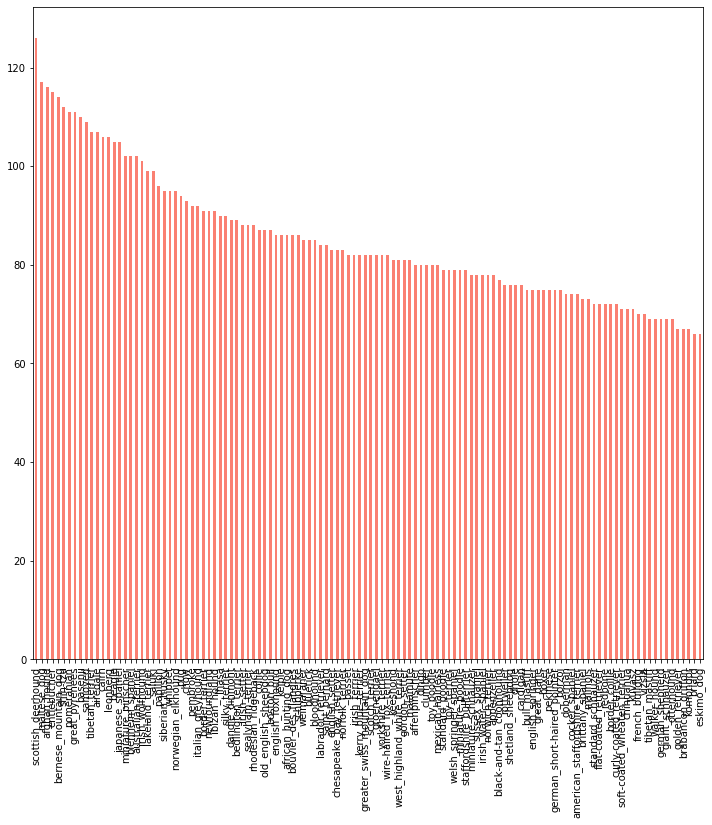

In [ ]:
 # check distribution of labels
 plt.figure(figsize=(12,12))
 plt.tight_layout()
 labels["breed"].value_counts().plot(kind="bar",color="salmon")


In [ ]:
labels["breed"].value_counts().mean()

85.18333333333334

In [ ]:
labels["breed"].value_counts().median()


82.0

*Mean is 85, median is 82  samples for each breed*. Min is 66 and max is 126. Thus pretty goood distribution of samples!!!!.
#### Min number of samples reccomended by google is 10. A good sample size is 100 samples per type. !!

In [ ]:
# import image from Ipython
from IPython.display import Image

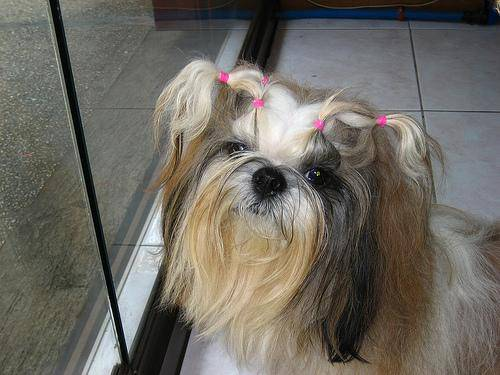

In [ ]:
# see a random image 
Image("/content/train/b31735ecd2e53d59cdbf2f668aab027b.jpg")

## Getting images and labels 
Get list of all image path names 

In [ ]:
labels.head()

,id,breed
0,000bec180eb18c7604dcecc8fe0dba07,boston_bull
1,001513dfcb2ffafc82cccf4d8bbaba97,dingo
2,001cdf01b096e06d78e9e5112d419397,pekinese
3,00214f311d5d2247d5dfe4fe24b2303d,bluetick
4,0021f9ceb3235effd7fcde7f7538ed62,golden_retriever


In [ ]:
# create string list for all filenames
filenames = [f"/content/train/{id}.jpg" for id in labels["id"]]

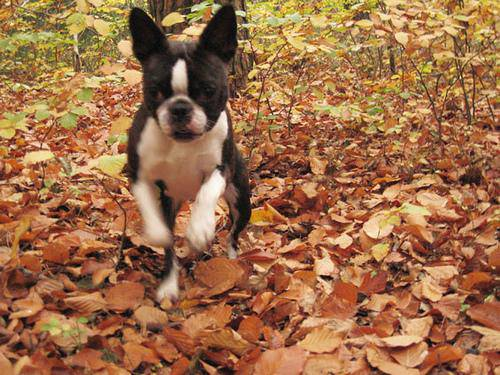

In [ ]:
#check if good !!
Image(filenames[0])


In [ ]:
# check if filenames matches image files
import os 
if len(os.listdir("/content/train/")) == len(filenames):
  print("Same num of filenames as list created YAYY. Move on")
else:
    print("Error, please fix")


Same num of filenames as list created YAYY. Move on


## Look at tensforflow image classification documentation tutorial for similar but different way to do image classification 
https://www.tensorflow.org/tutorials/images/classification

##  Convert labels(breed types) to numbers
- Convert to numpy array
- check if len is same to ensure no missing values 
- Convert to numbers. turn every array into boolean array 


In [ ]:
# Convert breed column to numpy array 
breeds = labels["breed"].to_numpy()

In [ ]:
# check if labels match filenames again 
if len(os.listdir("/content/train/")) == len(breeds):
  print("Yayy algood")
else:
  print("Error check again ")

Yayy algood


In [ ]:
# convert all breeds to numbers 
unique_breeds = np.unique(breeds)
#check length is 120 
len(unique_breeds)

120

In [ ]:
# convert each breed to array of boleans
# test 
breeds[0] == unique_breeds

array([False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False,  True, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False])

In [ ]:
breeds_bool_array = [breed == unique_breeds for breed in breeds]

In [ ]:
# check first and match with test 
breeds_bool_array[0]

array([False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False,  True, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False])

In [ ]:
# check length is good!
len(breeds_bool_array)

10222

In [ ]:
# Turn bool array to integers
print(breeds[0])
print(np.where(breeds[0] == unique_breeds)) # index where true 
print(breeds_bool_array[0].argmax()) # index where label occurs in bool array
# print as an int
print(breeds_bool_array[0].astype(int))

boston_bull
(array([19]),)
19
[0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0]


### Split training data into 2 Sets: Training and Validation set!
- Create X,y,test 1000 images first and increase as needed. To improve speed b/w experiments. Train test split with sckit learn.



In [ ]:
# Split into X and y. data and images. 
X = filenames
y = breeds_bool_array

In [ ]:
# Adjust training data size for faster experimentation 
NUM_IMAGES = 1000 #@param {type:"slider", min:1000,max:10000,step:1000}

In [ ]:
# split up into training and validation using sklearn train test split
from sklearn.model_selection import train_test_split


In [ ]:
# split with size being num of images 
X_train, X_val, y_train, y_val = train_test_split(X[:NUM_IMAGES], y[:NUM_IMAGES], test_size=0.2, random_state=42)


In [ ]:
# check lengths to ensure no errors 
print(len(X_val), len(X_train), len(y_val), len(y_train))

200 800 200 800


In [ ]:
#check if allgood 
print(X_train[:2],y_train[:2])

['/content/train/00bee065dcec471f26394855c5c2f3de.jpg', '/content/train/0d2f9e12a2611d911d91a339074c8154.jpg'] [array([False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False,  True,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False, False, False, False,
       False, False, False, False, False, False,

## Preprocess Images - Convert images into tensors
Create function that: 
- Takes image filepath
- Use tf to read and save as variable `image`
- Turn `image` into tensors
- Normalize color channels from 0-255 to 0-1
- Resize `image` to be (224,224)



In [ ]:
# Test how images will be converted to numpy arrays
image = plt.imread(filenames[0])

In [ ]:
#check shape
image.shape

(375, 500, 3)

In [ ]:
#check. Just array of colors from 0-255
image

array([[[109,  46,   0],
        [153,  91,  40],
        [180, 120,  68],
        ...,
        [176, 144,  71],
        [189, 157,  84],
        [214, 182, 109]],

       [[153,  92,  47],
        [179, 121,  75],
        [167, 111,  64],
        ...,
        [167, 135,  58],
        [171, 139,  62],
        [188, 156,  79]],

       [[152,  97,  56],
        [189, 136,  94],
        [164, 113,  70],
        ...,
        [200, 168,  81],
        [194, 162,  75],
        [200, 168,  81]],

       ...,

       [[189, 122,  69],
        [186, 119,  66],
        [183, 116,  63],
        ...,
        [213, 160, 108],
        [212, 159, 107],
        [209, 156, 104]],

       [[186, 119,  66],
        [184, 117,  64],
        [183, 116,  63],
        ...,
        [197, 145,  88],
        [199, 147,  90],
        [199, 147,  90]],

       [[182, 115,  62],
        [181, 114,  61],
        [183, 116,  63],
        ...,
        [184, 132,  74],
        [190, 138,  80],
        [192, 140,  82]]

In [ ]:
# convert image to tensors - now can use GPU for faster computation
tf.constant(image)

<tf.Tensor: shape=(375, 500, 3), dtype=uint8, numpy=
array([[[109,  46,   0],
        [153,  91,  40],
        [180, 120,  68],
        ...,
        [176, 144,  71],
        [189, 157,  84],
        [214, 182, 109]],

       [[153,  92,  47],
        [179, 121,  75],
        [167, 111,  64],
        ...,
        [167, 135,  58],
        [171, 139,  62],
        [188, 156,  79]],

       [[152,  97,  56],
        [189, 136,  94],
        [164, 113,  70],
        ...,
        [200, 168,  81],
        [194, 162,  75],
        [200, 168,  81]],

       ...,

       [[189, 122,  69],
        [186, 119,  66],
        [183, 116,  63],
        ...,
        [213, 160, 108],
        [212, 159, 107],
        [209, 156, 104]],

       [[186, 119,  66],
        [184, 117,  64],
        [183, 116,  63],
        ...,
        [197, 145,  88],
        [199, 147,  90],
        [199, 147,  90]],

       [[182, 115,  62],
        [181, 114,  61],
        [183, 116,  63],
        ...,
        [184, 132,  7

create function for preprocess image takes path and imae size
- IMG_size=224
- tf.io.read_file(filename)
- turn jpeg image into tensors with the 3 color chanels- tf.image.decode_jpeg(image,channels) => does same as tf.constant
- Normalize colors from 0-255 to 0-1
use tf.image.convert_image_dtype(tensors,tf.float32)
- Resize image to 224x2224
tf.image.resize(height,width)
- return the image


In [ ]:
def preprocess_image(filepath,img_size=224):
  """
  This function takes in a image filepath and image size and
  returns a processed image witht the given image size.
  default image size is 224. 
  """
  # read in file with tf
  image = tf.io.read_file(filepath)
  # convert into  tensors with 3 color channels 
  image = tf.image.decode_jpeg(image,channels=3)
  # normalize color channels to be b/w 0-1
  image = tf.image.convert_image_dtype(image,tf.float32)
  # resize image by input  
  image = tf.image.resize(image,size=[img_size,img_size])
  return image   


#### Turn our data into batches 
*Good size is 32 usally*

If we try the whole set(10,000) we might run out of memory!!! SO thats why we are doing 32 at a time. 

We need data in the form of Tensor tuples `(image,label)`

In [ ]:
# Create function to return tuple of tensors
def get_image_label(img_path,label):
  """
  Takes image filepath and its corresponding label and then
  preprocesses image and returns the processed image and label as a tuple.
  """
  # pass through processing function
  image = preprocess_image(img_path)
  return image,label


In [ ]:
# Test above function 
get_image_label(X[0],tf.constant(y[0]))

(<tf.Tensor: shape=(224, 224, 3), dtype=float32, numpy=
 array([[[0.5705322 , 0.33588538, 0.15008473],
         [0.66901225, 0.4601166 , 0.26022965],
         [0.61062384, 0.43763596, 0.21601713],
         ...,
         [0.8182312 , 0.7297958 , 0.26963907],
         [0.72454786, 0.6059109 , 0.2653059 ],
         [0.7494603 , 0.6252918 , 0.32456532]],
 
        [[0.6761415 , 0.4733761 , 0.30642927],
         [0.5672121 , 0.38192675, 0.20349538],
         [0.5883547 , 0.4322571 , 0.2403155 ],
         ...,
         [0.9326942 , 0.8260503 , 0.41093278],
         [0.86072475, 0.74250627, 0.3694122 ],
         [0.76781666, 0.6461604 , 0.29291284]],
 
        [[0.46350825, 0.29595745, 0.1536156 ],
         [0.42554107, 0.27039403, 0.12009468],
         [0.7887875 , 0.6547362 , 0.49015   ],
         ...,
         [0.89372385, 0.7696401 , 0.41811958],
         [0.88609535, 0.7585918 , 0.36495727],
         [0.8243601 , 0.69494826, 0.2930575 ]],
 
        ...,
 
        [[0.7344025 , 0.4716574 

Now data in tensor tuples. lets turn all our data into batches now 

In [ ]:
# Create a function to turn data into bacthes 
# use 32 as batch size 
BATCH_SIZE = 32
def data_batching(X,y=None,batch_size=BATCH_SIZE,valid_data=False,test_data=False):
  """
  Create batches of data out of images paths(X) and its labels (y).
  Shuffles training data but not validation data.
  Accepts test data with no labels(y) as well. 
  Booleans for validation set and test set parameters
  """
  # With test data we dont have labels.
  if test_data:
    print("Creating TEST data batches...")
    # filenames into tensors 
    data = tf.data.Dataset.from_tensor_slices(tf.constant(X))
    # Preporcess image and then map out into batches of 32 
    data_batch = data.map(preprocess_image).batch(batch_size)
    return data_batch
    
  # If validation dataset. we dont have to shuffle the dataset
  elif valid_data:
    print("Creating VALIDATION data batches...")
    # (filenames, labels) tuple into tensors 
    data = tf.data.Dataset.from_tensor_slices((tf.constant(X),
                                                   tf.constant(y)))
    #call get_image_label and batch    
    data_batch = data.map(get_image_label).batch(batch_size)
    return data_batch

  # Training set
  print("Creating TRAINING dataset.....")
  # (filenames, labels) tuple into tensors 
  data = tf.data.Dataset.from_tensor_slices((tf.constant(X),
                                                  tf.constant(y)))
  # shuffle pathnames before mapping!! using tensor flow shuffle
  data = data.shuffle(buffer_size=len(X))
  #call get_image_label and batch 
  data_batch = data.map(get_image_label).batch(batch_size)
  return data_batch


In [ ]:
# create training and validataion training data batches
train_data = data_batching(X_train,y_train)
val_data = data_batching(X_val,y_val,valid_data=True)

Creating TRAINING dataset.....
Creating VALIDATION data batches...


In [ ]:
# check differetent attributes 
train_data.element_spec, val_data.element_spec
# shape=(batchesize,imgsize,img,size,colorchanels)

((TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)),
 (TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None),
  TensorSpec(shape=(None, 120), dtype=tf.bool, name=None)))

## Vizualize data 
Data now in batches. But lets visualize to see this 






In [ ]:
# create function to view images in a data batch
def show_images(images,labels):
  """
  Display a plot for first 16 images  with labels!!
  """
  plt.figure(figsize=(10, 10))
  for i in range(16):
    # create subplots( rows,cols,index)
    ax = plt.subplot(4,4, i + 1)
    # display the image
    plt.imshow(images[i])
    # add title as labels 
    plt.title(unique_breeds[labels[i].argmax()])
    # turn off grid lines 
    plt.axis("off")
  


In [ ]:
#check how it indexes the title
unique_breeds[y[0].argmax()]

'boston_bull'

In [ ]:
# convert our batches to an iterator to loop through and visualise our function
train_images,train_labels = next(train_data.as_numpy_iterator())
len(train_images), len(train_labels)

(32, 32)

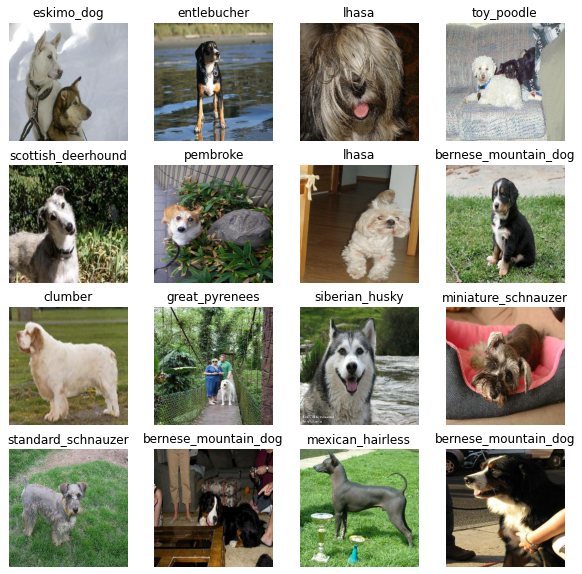

In [ ]:
# Visualize the data in training batch
show_images(train_images,train_labels)

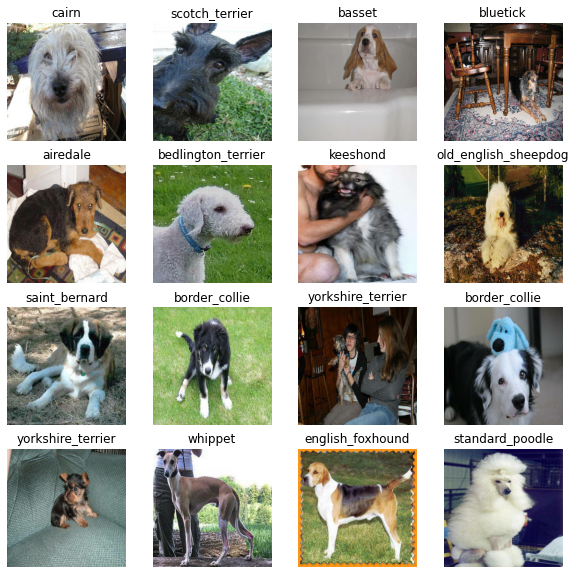

In [ ]:
# visualize our training batchh 
val_images,val_labels = next(val_data.as_numpy_iterator())
show_images(val_images,val_labels)

*Note: Training images gets mixed each time as we shuffle our training batches.  But validataion ones stay the same.*

## Building a Model 
We will use transfer learning and get a  model from tensorflow hub. 
We need to define the following:
- The input shape(images shape in terms of tensors) to our model
- The output shape(labels shape in tensors) of our model 
- URL of model we want from tensorflow hub - [mobile net](https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4/)

In [ ]:
# setup the input shape to model
INPUT_SHAPE = [None,224,224,3] # batch,height,width,color chanels
# setup output shape to model
OUTPUT_SHAPE = len(unique_breeds)
# Setup model URL from Tensorflow hub
MODEL_URL = "https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4"

Create a function which:
- takes the input shape,output shape and our model as params. 
-Defines the layers
- Compiles model 
- Builds te model 
- Returns the model 

In [ ]:
import tensorflow_hub as hub

In [ ]:
# create function which builds Keras model 
def create_model(input_shape=INPUT_SHAPE,output_shape=OUTPUT_SHAPE,model_url=MODEL_URL):
  print("Building a model with: ", model_url)

  # setup our model layers
  model = tf.keras.Sequential([
                         hub.KerasLayer("https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4"), # input layer 
                         tf.keras.layers.Dense(OUTPUT_SHAPE,
                                               activation="softmax") # output layer
                               
  ])
  # Compile the model 
  model.compile(optimizer = "adam",
    loss = tf.keras.losses.CategoricalCrossentropy(),
    metrics=["accuracy"]
  )
  # build the model 
  model.build(input_shape)
  return model

In [ ]:
# create model 
model = create_model()

Building a model with:  https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4


In [ ]:
# get summary of model 
model.summary()

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
keras_layer_1 (KerasLayer)   (None, 1001)              5432713   
_________________________________________________________________
dense_1 (Dense)              (None, 120)               120240    
Total params: 5,552,953
Trainable params: 120,240
Non-trainable params: 5,432,713
_________________________________________________________________


See non trainable params line up with keras layer(mobilenet) and dense layer lines up with trainable params.

Thus we will use 120,240 in the dense layer obtained from the original mobilenet model 

### Below shows how a CNN works
Have a input with conv + pooling layers. Then you flaten and fully connect. Then have a final output layer(softmax in this case)

**Our mobilenet model from tf hub does alot of the layers for us!!! This gives array of 1x1x1280. But we just add our dense layer at the end as our outputs only need 120!!!!!**


<img src="https://miro.medium.com/max/2510/1*vkQ0hXDaQv57sALXAJquxA.jpeg" width=500/>

#### Callbacks 
Helper functions that do things such as tensorboard,earlystopping,.. etc other things....

We will create 2 callbacks 
- Tensorboard - we need 3 things:
  1. load tensorboard extenstin
  2. create tensorboard callback which is able to save logs to a directory and pass it to our models `fit()` function.
  3. Visualize using `%tensorboard` magic fucntion 

- EarlyStopping



In [ ]:
# Tensorboard Callback 
# load tensorboard notebook extension 
%load_ext tensorboard

In [ ]:
import datetime 
# directory called logs where we will store our logs
# append the time so it tracks when the expirement was run 
logdir = os.path.join("/content/logs/fit",datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir,histogram_freq=1)


In [ ]:
# Early stopping - prevent overfitting
early_stopping = tf.keras.callbacks.EarlyStopping(monitor="val_accuracy",patience=3)

## Model Training (subset of data)
We will train on 1000 images first to ensure everything is working and save time betweeen experiments. 




In [ ]:
# we have early stopping so high is good because it wll stop early
NUM_EPOOCHS = 100 #@param {type:"slider",min:10,max:100,step:10}

In [ ]:
# fit the model 
# 25 steps as 800 images and 32 batches 800/32
model.fit(x=train_data,
          epochs=NUM_EPOOCHS,
          validation_data=val_data,
          validation_freq=1,
          verbose=1,
          callbacks=[tensorboard_callback,early_stopping])

Epoch 1/100
25/25 [==============================] - 15s 195ms/step - loss: 5.2265 - accuracy: 0.0326 - val_loss: 3.3514 - val_accuracy: 0.2550
Epoch 2/100
25/25 [==============================] - 4s 140ms/step - loss: 1.8677 - accuracy: 0.6462 - val_loss: 2.1085 - val_accuracy: 0.5050
Epoch 3/100
25/25 [==============================] - 4s 153ms/step - loss: 0.6413 - accuracy: 0.9337 - val_loss: 1.5835 - val_accuracy: 0.6100
Epoch 4/100
25/25 [==============================] - 4s 153ms/step - loss: 0.2685 - accuracy: 0.9836 - val_loss: 1.4321 - val_accuracy: 0.6250
Epoch 5/100
25/25 [==============================] - 4s 156ms/step - loss: 0.1493 - accuracy: 0.9985 - val_loss: 1.3657 - val_accuracy: 0.6400
Epoch 6/100
25/25 [==============================] - 4s 157ms/step - loss: 0.1022 - accuracy: 1.0000 - val_loss: 1.3123 - val_accuracy: 0.6550
Epoch 7/100
25/25 [==============================] - 4s 157ms/step - loss: 0.0754 - accuracy: 1.0000 - val_loss: 1.2833 - val_accuracy: 0.660

In [ ]:
# gives all these metrics we can now plot
model_hist = pd.DataFrame(model.history.history)
model_hist

,loss,accuracy,val_loss,val_accuracy
0,4.623040,0.08875,3.351391,0.255
1,1.624858,0.70125,2.108516,0.505
2,0.573305,0.93875,1.583542,0.610
3,0.254632,0.98250,1.432103,0.625
4,0.148019,0.99625,1.365692,0.640
5,0.099869,1.00000,1.312339,0.655
6,0.075390,1.00000,1.283317,0.660
7,0.059979,1.00000,1.272753,0.655
8,0.049182,1.00000,1.249738,0.655
9,0.041357,1.00000,1.235317,0.680


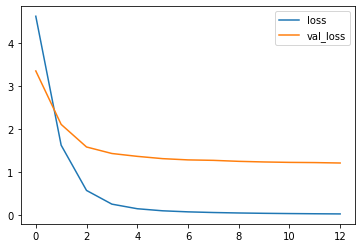

In [ ]:

model_hist[["loss","val_loss"]].plot()

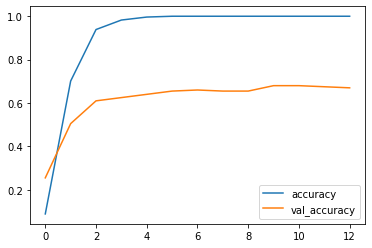

In [ ]:
model_hist[["accuracy","val_accuracy"]].plot()

We can see our model dosent do too well on validation set. 68% accuarcy compared to 100. 

Also the model is overfitting and could have been stopped much earlier, as loss and accuracy doesnt change much after 10 epoochs.

We can also visualize our fitting using tensorboard.

In [ ]:
#check tensorboard logs directiory 
%tensorboard --logdir logs/fit

<IPython.core.display.Javascript object>

###  Predictions 


In [ ]:
# make predictions on validation set
y_preds = model.predict(val_data,verbose=1)
y_preds

7/7 [==============================] - 1s 108ms/step


array([[3.5322222e-03, 1.1426235e-04, 3.2544436e-04, ..., 8.8399037e-04,
        3.2837928e-05, 8.8966952e-04],
       [5.3914287e-03, 2.2626994e-04, 9.4772791e-03, ..., 6.0000410e-04,
        1.7685940e-03, 3.1869579e-04],
       [2.9891278e-06, 1.2217702e-04, 4.5048480e-04, ..., 1.0890889e-05,
        5.3643911e-05, 3.8464063e-05],
       ...,
       [4.5773268e-06, 1.6272092e-05, 7.2484909e-05, ..., 7.0703809e-06,
        9.5521907e-05, 1.8396524e-05],
       [6.6397884e-03, 3.6314502e-04, 7.3300456e-05, ..., 7.3593947e-05,
        2.6511738e-05, 1.7078498e-02],
       [1.2393137e-03, 5.0373470e-05, 2.9250485e-04, ..., 1.4990378e-03,
        3.5191581e-03, 9.3326649e-05]], dtype=float32)

In [ ]:
y_preds.shape

(200, 120)

In [ ]:
print(len(y_val)), len(unique_breeds)

200


(None, 120)

In [ ]:
len(y_preds[0])

120

In [ ]:
# total pred probabilites = 1
np.sum(y_preds[0])

0.9999999

Y_preds gives us all the samples (200) and a corresponding prediction probability for each dog breed(120). The highest value is the dog breed chosen. kinda like `predict_proba()`

Softax so preds in total = 1

In [ ]:
# thus prediction of breed for first 
print(f"Max probaility is: {y_preds[0].max()}") # also called confidence interval
print(f"index at max probaility is: {y_preds[0].argmax()}")
print(f"Dog breed predicted is : {unique_breeds[y_preds[0].argmax()]}")

Max probaility is: 0.3159996569156647
index at max probaility is: 17
Dog breed predicted is : border_terrier


We want to do the above functionality at scale and also be able to see the images. 



In [ ]:
# Turn prediction probailities of a prediction to their respective label 
def get_pred_label(prediction_probabilities):
  """
  Turns an array of prediction proabilites to corresponding breed label.
  """
  return unique_breeds[np.argmax(prediction_probabilities)]

In [ ]:
# test function to see if working like above 
get_pred_label(y_preds[0])


'border_terrier'

Validation data in batchDataset. But we have to sepearte the images and labels so we can compare labels to our predictions

In [ ]:
val_data

<BatchDataset shapes: ((None, 224, 224, 3), (None, 120)), types: (tf.float32, tf.bool)>

In [ ]:
# create function to unbatch validataion data
def unbatchify(data):
  """
  This function will take a batch dataset and unbatch it.
  Returning a list of  images and labels seperately.
  """
  images_ = []
  labels_ = []
  unbatched_data = data.unbatch().as_numpy_iterator()
  for image,label in unbatched_data:
    images_.append(image)
    labels_.append(unique_breeds[label.argmax()])
  return images_,labels_

In [ ]:
val_images,val_labels = unbatchify(val_data)

In [ ]:
# check if working to see image label pair
print(val_images[0],val_labels[0])

[[[0.29599646 0.43284872 0.3056691 ]
  [0.26635826 0.32996926 0.22846507]
  [0.31428418 0.2770141  0.22934894]
  ...
  [0.77614343 0.82320225 0.8101595 ]
  [0.81291157 0.8285351  0.8406944 ]
  [0.8209297  0.8263737  0.8423668 ]]

 [[0.2344871  0.31603682 0.19543913]
  [0.3414841  0.36560842 0.27241898]
  [0.45016077 0.40117094 0.33964607]
  ...
  [0.7663987  0.8134138  0.81350833]
  [0.7304248  0.75012016 0.76590735]
  [0.74518913 0.76002574 0.7830809 ]]

 [[0.30157745 0.3082587  0.21018331]
  [0.2905954  0.27066195 0.18401104]
  [0.4138316  0.36170745 0.2964005 ]
  ...
  [0.79871625 0.8418535  0.8606443 ]
  [0.7957738  0.82859945 0.8605655 ]
  [0.75181633 0.77904975 0.8155256 ]]

 ...

 [[0.9746779  0.9878955  0.9342279 ]
  [0.99153054 0.99772066 0.9427856 ]
  [0.98925114 0.9792082  0.9137934 ]
  ...
  [0.0987601  0.0987601  0.0987601 ]
  [0.05703771 0.05703771 0.05703771]
  [0.03600177 0.03600177 0.03600177]]

 [[0.98197854 0.9820659  0.9379411 ]
  [0.9811992  0.97015417 0.9125648 ]


In [ ]:
# check actual label for first
val_labels[0]

'cairn'

We need :
- Pred labels
- validation labels(actual)
- validataion images

Function to visualize all this
- Takes array of prediction probailities and arrya of truth labels and array of images and integer. 
- Convert prediction probailities to lablel.
- Plot predicted label,its predicted probaility and truth label and target image on same plot. 

In [ ]:
# function to plot predicted and truth 
def plot_predicted(prediction_probabilities,images,labels,n=0):
  """
  This function takes the predictions and test images an labels, and n,
  which is the prediction to be plotted. This then plots them both. 
  """
  
  pred_prob,true_label,image = prediction_probabilities[n],labels[n],images[n]
  # get pred label at n
  pred_label = get_pred_label(pred_prob)
  # plot image and remove tick s
  plt.imshow(image)
  plt.xticks([])
  plt.yticks([])
  # green color if right else red if wrong
  if pred_label == true_label:
    color = "green"
  else:
    color = "red"
  # changle plots title to show comparison
  plt.title("Pred: {}, probability: {:2.0f}%, truth: {}".format(
      pred_label,pred_prob.max()*100,true_label
  ),color=color)

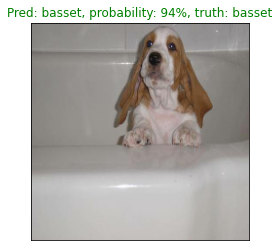

In [ ]:
# plot  image to check!!

plot_predicted(y_preds,val_images,val_labels,n=2)
# right prediction

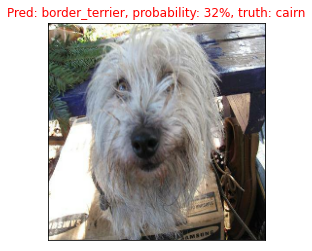

In [ ]:
plot_predicted(y_preds,val_images,val_labels,n=0)
# wrong prediction

Lets make another function to view our models top 10 predictions 
The function will:
- Input of prediction probabilities array, ground truth and integer
- find pred label using `get_pred_label`
- Find top 10 :
  - prediction probability indexes
  - prediction probability values 
  - prediction labels
- Plot the top 10 prediction probability values and labels, coloring the true label in green

In [ ]:
def plot_top10(prediction_probabilities,labels,n=0):
  """
  Plot top 10 prediction confidences along with truth label for 
  given sample n.
  """
  pred_probs, true_label = prediction_probabilities[n], labels[n]

  # get predicted label 
  pred_label = get_pred_label(pred_probs)

  # find top 10 prediction confidence indexes
  top10_indexes = pred_probs.argsort()[-10:][::-1]
  # get top 10 values 
  top10_values = pred_probs[top10_indexes]
  # find top 10 prediction labels 
  top10_labels = unique_breeds[top10_indexes]  
  # setup plot
  # bar plot with 10 values and heights as values 
  top_plot = plt.bar(np.arange(10), # x labels 0-10
                     top10_values, # height is values
                     color="grey")
  # label bottom as breed labels 
  plt.xticks(np.arange(10), # redo 10 ticks
             labels=top10_labels, # labels are the top10 breed labels
             rotation="vertical") # rotate labels to fit
  # highlight bar greeen if true label 
  # if in top 10 labels 
  if np.isin(true_label, top10_labels): # is true label is top 10?
    top_plot[(top10_labels == true_label).argmax()].set_color("green")
  else:
    pass


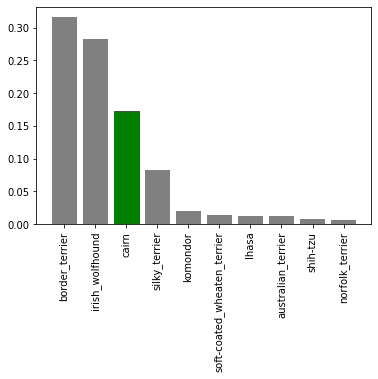

In [ ]:
# test it out!!!

plot_top10(y_preds,val_labels,n=0)
# wrong pred

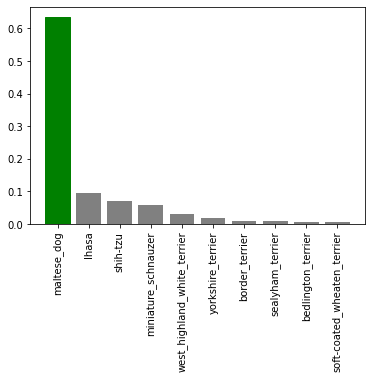

In [ ]:
plot_top10(y_preds,val_labels,n=198)
# right 

We can now see top 10 predictions and actual prediction 

In [ ]:
# trail argosrt to get top 10 
# ypi can see top 10 are last 10 
y_preds[0].argsort()

array([ 22,  24,  19,  92, 112, 118,  94,  63, 113,  69,  18,  33, 108,
        30,  51,   5,  43,  25,  46,  16,  61, 115, 101, 111,  13,  54,
        44,  36,  56,  87,  27,  29,  84,  41,   3,  89,  28, 107,  50,
        34,  72, 117,  64,  75,  11,  53,  99,  12,  86,  52,  38,  82,
       114,  39,  45,   4,  67,  58,  85,  71,  66, 104,  10,  47,  14,
       110,  48,  55, 119,  57,  74,  80,  32,  21,  81, 105,  49,  98,
         1,  40,  88,  91,  90,   8,  15,  20,  78,   9,   7,  62,  60,
        76,  95,   2,  96,   0,  42,  93,  37, 109,  31,  23,  68,  79,
        83, 116, 100,  97,  65,  35,  77,  73, 102,  59,  70,   6, 103,
       106,  17,  26])

In [ ]:
# grab last 10, [::-1] flips array
# now index these to get top 10 
y_preds[0].argsort()[-10:][::-1]

array([ 26,  17, 106, 103,   6,  70,  59, 102,  73,  77])

In [ ]:
# top 10 yayy
y_preds[0][y_preds[0].argsort()[-10:][::-1]]

array([0.24071279, 0.15020852, 0.12221623, 0.07066444, 0.05528972,
       0.04644004, 0.04329587, 0.04204982, 0.02429946, 0.02412973],
      dtype=float32)

In [ ]:
unique_breeds[y_preds[0].argsort()[-10:][::-1]]

array(['cairn', 'border_terrier', 'standard_schnauzer',
       'soft-coated_wheaten_terrier', 'australian_terrier', 'lhasa',
       'irish_wolfhound', 'silky_terrier', 'maltese_dog',
       'miniature_schnauzer'], dtype=object)

Lets see some more predictions and they 2 functions side by side 

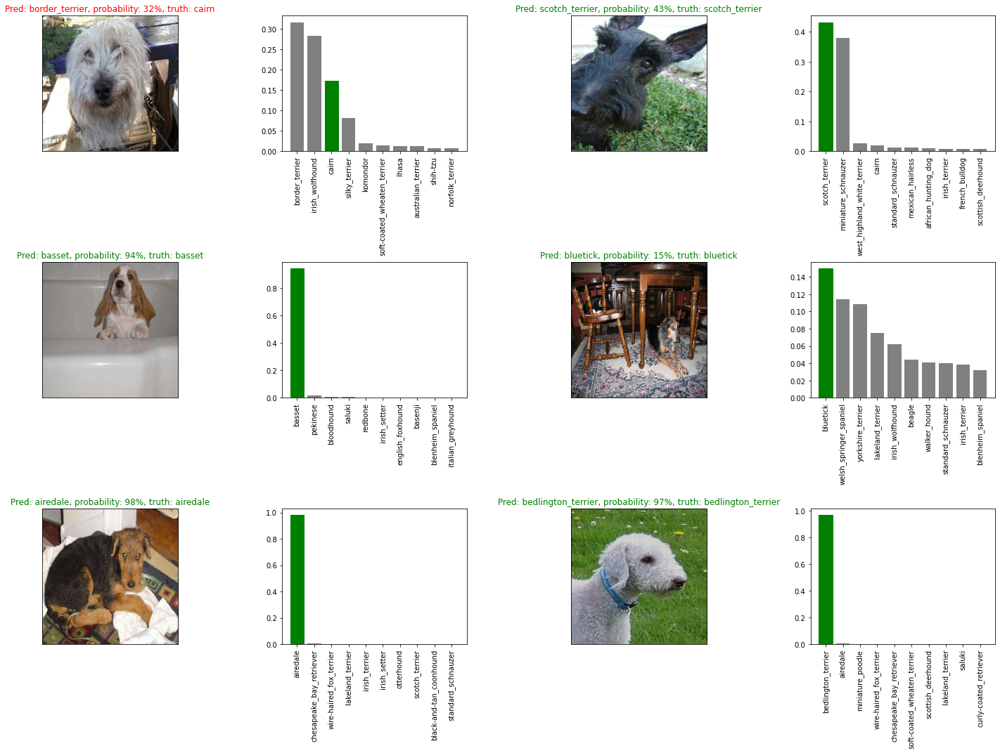

In [ ]:
# check some more predictions witht the 2 functions 
# plot 6 images, 3x2 subplot
n_mult = 0 # start index of prediction label 
# figsize is 10*cols,5*rows
plt.figure(figsize=(10*2,5*3))
# go throuh and plot 6
for i in range(6):
  # plot image function
  plt.subplot(3,2*2, 2*i+1)
  plot_predicted(y_preds,val_images,val_labels,n=i+n_mult)
  # plot corresponding top10 bar chart
  plt.subplot(3,2*2, 2*i+2)
  plot_top10(y_preds,val_labels,n=i+n_mult)

plt.tight_layout(h_pad=1)
plt.show()

Lets try evaulate our predictions using a confusion matrix, classification report 

In [ ]:
from sklearn.metrics import confusion_matrix,classification_report

In [ ]:
# list of all predicted labels
y_pred_labels = [get_pred_label(pred) for pred in y_preds]
y_pred_labels

['border_terrier',
 'scotch_terrier',
 'basset',
 'bluetick',
 'airedale',
 'bedlington_terrier',
 'keeshond',
 'old_english_sheepdog',
 'saint_bernard',
 'collie',
 'irish_wolfhound',
 'great_pyrenees',
 'yorkshire_terrier',
 'whippet',
 'english_foxhound',
 'miniature_poodle',
 'irish_setter',
 'african_hunting_dog',
 'labrador_retriever',
 'irish_water_spaniel',
 'golden_retriever',
 'samoyed',
 'cairn',
 'blenheim_spaniel',
 'welsh_springer_spaniel',
 'scottish_deerhound',
 'komondor',
 'cairn',
 'cardigan',
 'dingo',
 'dandie_dinmont',
 'walker_hound',
 'english_foxhound',
 'cairn',
 'malamute',
 'malamute',
 'welsh_springer_spaniel',
 'doberman',
 'dhole',
 'kuvasz',
 'labrador_retriever',
 'lakeland_terrier',
 'walker_hound',
 'collie',
 'miniature_poodle',
 'groenendael',
 'boston_bull',
 'irish_water_spaniel',
 'miniature_poodle',
 'chihuahua',
 'staffordshire_bullterrier',
 'chesapeake_bay_retriever',
 'norfolk_terrier',
 'pug',
 'toy_poodle',
 'affenpinscher',
 'border_terri

In [ ]:
# confusion matrix 
print(confusion_matrix(val_labels,y_pred_labels))

[[2 0 0 ... 0 0 0]
 [0 4 0 ... 0 0 0]
 [0 0 2 ... 0 0 0]
 ...
 [0 0 0 ... 2 0 0]
 [0 0 0 ... 0 1 0]
 [0 0 0 ... 0 0 2]]


In [ ]:
# classification report 
print(classification_report(val_labels,y_pred_labels))

                             precision    recall  f1-score   support

              affenpinscher       0.67      1.00      0.80         2
               afghan_hound       1.00      1.00      1.00         4
        african_hunting_dog       1.00      1.00      1.00         2
                   airedale       1.00      0.67      0.80         3
                appenzeller       0.67      0.50      0.57         4
         australian_terrier       0.00      0.00      0.00         1
                    basenji       0.67      1.00      0.80         2
                     basset       1.00      0.50      0.67         2
                     beagle       0.00      0.00      0.00         2
         bedlington_terrier       1.00      0.75      0.86         4
       bernese_mountain_dog       0.75      1.00      0.86         3
           blenheim_spaniel       1.00      0.75      0.86         4
                 bloodhound       0.50      1.00      0.67         1
                   bluetick      

/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.6/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


## Save Model 
Lets save and reload just incase colab restarts and for future profing. 

In [ ]:
# create function to save model 
def save_model(model,suffix=None):
  """
  This function saves a model with a suffix.
  """
  model_path = os.path.join("/content/drive/MyDrive/models",
                            datetime.datetime.now().strftime("%Y%m%d-%H%M%s"))
  model_path = model_path + "-" + suffix + ".h5" # .h5 extension
  # save the model 
  model.save(model_path)

  return model_path



In [ ]:
# create function to load model 
def load_model(model_path):
  """
  This function loads a model 
  """

  # load model - need custom object as we are using tf hub model 
  model = tf.keras.models.load_model(model_path,
                                     custom_objects={"KerasLayer":hub.KerasLayer})
  return model 

In [ ]:
# save our model on 1000 images 
save_model(model,suffix="1000-images-mobilenetV2")

'/content/model/20210105-19421609875761-1000-images-mobilenetV2.h5'

In [ ]:
# load model 
loaded_model = load_model("/content/model/20210105-04551609822521-1000-images-mobilenetV2.h5")

In [ ]:
# lets test this using evaluate
model.evaluate(val_data)

7/7 [==============================] - 1s 85ms/step - loss: 1.2453 - accuracy: 0.6800


[1.2453043460845947, 0.6800000071525574]

In [ ]:
loaded_model.evaluate(val_data)

7/7 [==============================] - 1s 83ms/step - loss: 1.2453 - accuracy: 0.6800


[1.2453043460845947, 0.6800000071525574]

Saving and loading was good as the loss and accuracy values are the same 

## Train model on Full Dataset 
Currently only trained on 1000 images. So will now train on full 10,000 image dataset

In [ ]:
# check current lenghts 
len(X_train),len(X_val)

(800, 200)

In [ ]:
# first we have to batch our full dataset 
full_data = data_batching(X,y)

Creating TRAINING dataset.....


In [ ]:
full_data

<BatchDataset shapes: ((None, 224, 224, 3), (None, 120)), types: (tf.float32, tf.bool)>

In [ ]:
# create new model 
full_model = create_model()

Building a model with:  https://tfhub.dev/google/imagenet/mobilenet_v2_130_224/classification/4


In [ ]:
# create our early stopping callback 
# no val set so we cant monitor val_accuracy, we monitor accuracy 
early_stopping = tf.keras.callbacks.EarlyStopping(monitor="accuracy",patience=3) 


In [ ]:
# fit model to data
full_model.fit(x=full_data,epochs=100,
               callbacks=[tensorboard_callback,early_stopping])

Epoch 1/100
320/320 [==============================] - 41s 117ms/step - loss: 2.3137 - accuracy: 0.4894
Epoch 2/100
320/320 [==============================] - 36s 113ms/step - loss: 0.3929 - accuracy: 0.8888
Epoch 3/100
320/320 [==============================] - 35s 108ms/step - loss: 0.2213 - accuracy: 0.9421
Epoch 4/100
320/320 [==============================] - 34s 106ms/step - loss: 0.1497 - accuracy: 0.9654
Epoch 5/100
320/320 [==============================] - 34s 106ms/step - loss: 0.0976 - accuracy: 0.9810
Epoch 6/100
320/320 [==============================] - 34s 105ms/step - loss: 0.0699 - accuracy: 0.9903
Epoch 7/100
320/320 [==============================] - 34s 106ms/step - loss: 0.0563 - accuracy: 0.9915
Epoch 8/100
320/320 [==============================] - 34s 106ms/step - loss: 0.0447 - accuracy: 0.9946
Epoch 9/100
320/320 [==============================] - 35s 108ms/step - loss: 0.0359 - accuracy: 0.9952
Epoch 10/100
320/320 [==============================] - 36s 114m

In [ ]:
# save model 
save_model(full_model,"full-model")

'/content/drive/MyDrive/models/20210105-20421609879331-full-model.h5'

### Prediction on test dataset
Conver the test datset into same format as training set to be fed into the model.i.e batchify the test data using the list of filenames.



In [ ]:
# get image filenames into a list 
test_filepath = "/content/test/"
test_filenames = [test_filepath + file for file in os.listdir(test_filepath)]

In [ ]:
# check first few to see if okay
test_filenames[:5]

['/content/test/4b0ec028345775c33109897160d2e97a.jpg',
 '/content/test/dddb2b191e1b1de4867f6f5e81236312.jpg',
 '/content/test/c3794618f46522d52334aeac90f32e53.jpg',
 '/content/test/ae17d1bb016bb43cceece0318c5f2da7.jpg',
 '/content/test/bfb143bc5f8dce4d87b4904c4cd5bf66.jpg']

In [ ]:
# check length of test images(files)
len(test_filenames)

10357

In [ ]:
# create test data batch 
# note no labels!!!!
test_data = data_batching(test_filenames,test_data=True)

Creating TEST data batches...


In [ ]:
test_data

<BatchDataset shapes: (None, 224, 224, 3), types: tf.float32>

In [ ]:
# now we predict 
test_preds = full_model.predict(test_data,verbose=1)

324/324 [==============================] - 35s 106ms/step


**NOTE: 324 is 10357/BATCH_SIZE(32)**

In [ ]:
# now we will save the predictions to csv file 
np.savetxt("/content/drive/MyDrive/dog-classification-preds.csv",test_preds,delimiter=",")

In [ ]:
# lets load the predictions again to numpy array 
test_predictions = np.loadtxt("/content/drive/MyDrive/dog-classification-preds.csv",delimiter=",")

In [ ]:
## check if okay
test_predictions.shape

(10357, 120)

Allgood as 10357 predictions with prediction probailities of 120 breeds. 

Lets check some predicitons to see how they do

In [ ]:
get_pred_label(test_predictions[0])

'bull_mastiff'

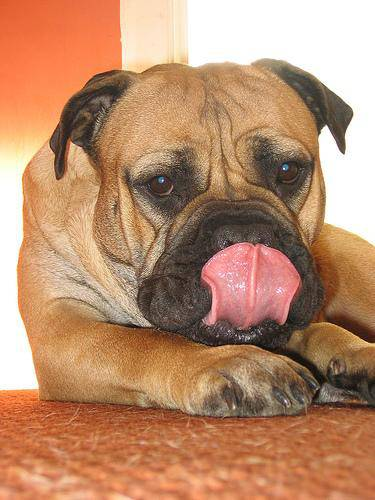

In [ ]:
Image(test_filenames[0])

Yayy correct 

In [ ]:
# function to compare predicted breed and actual breed(just photo)
def compare_pred(test_preds=test_predictions,test_filenames=test_filenames,n=0):
  """
  This function takes the test predictions and filenames, and a specific int n of prediction, 
  Showing the image n and the predicted label with its confidence.
  """
  print(f"Predicted label:{get_pred_label(test_preds[n])} at confidence: {test_preds[n].max()*100:.2f}%")
  # if just a sigular filename passed in
  if isinstance(test_filenames,str):
    return Image(test_filenames,width=224,height=224)

  return Image(test_filenames[n],width=224,height=224)

In [ ]:
isinstance(test_filenames,str)

False

Predicted label:bull_mastiff at confidence: 92.76%


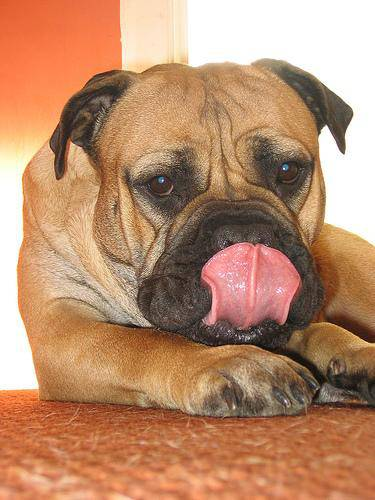

In [ ]:
# test function 
compare_pred(n=0)

Predicted label:wire-haired_fox_terrier at confidence: 99.02%


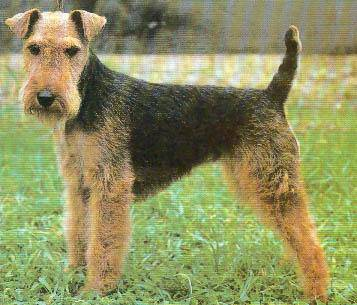

In [ ]:
# try another 
compare_pred(n=10000)

looks goood

Predicted label:gordon_setter at confidence: 99.99%


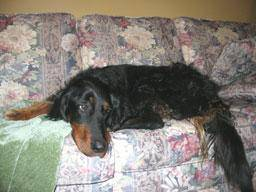

In [ ]:
# try one more 
compare_pred(n=4000)

looks pretty goood


## Submit to kaggle format
Create a pandas dataframe to save in format that kaggle needs it. See in link : https://www.kaggle.com/c/dog-breed-identification/overview/evaluation

In [ ]:
# need dataframe in size of predictons index by columns 
test_predictions.shape

(10357, 120)

In [ ]:
# split filenames into dog ids
test_ids = [file.split(".")[0] for file in os.listdir(test_filepath)]
test_ids[0]

'4b0ec028345775c33109897160d2e97a'

In [ ]:
# convert predictions to a data frame and save as csv 
kaggle_sub_df = pd.DataFrame(data=test_predictions,
                             index=test_ids,
                             columns = unique_breeds) 

In [ ]:
kaggle_sub_df.head()

,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,beagle,bedlington_terrier,bernese_mountain_dog,black-and-tan_coonhound,blenheim_spaniel,bloodhound,bluetick,border_collie,border_terrier,borzoi,boston_bull,bouvier_des_flandres,boxer,brabancon_griffon,briard,brittany_spaniel,bull_mastiff,cairn,cardigan,chesapeake_bay_retriever,chihuahua,chow,clumber,cocker_spaniel,collie,curly-coated_retriever,dandie_dinmont,dhole,dingo,doberman,english_foxhound,...,norwegian_elkhound,norwich_terrier,old_english_sheepdog,otterhound,papillon,pekinese,pembroke,pomeranian,pug,redbone,rhodesian_ridgeback,rottweiler,saint_bernard,saluki,samoyed,schipperke,scotch_terrier,scottish_deerhound,sealyham_terrier,shetland_sheepdog,shih-tzu,siberian_husky,silky_terrier,soft-coated_wheaten_terrier,staffordshire_bullterrier,standard_poodle,standard_schnauzer,sussex_spaniel,tibetan_mastiff,tibetan_terrier,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier
4b0ec028345775c33109897160d2e97a,2.877150e-07,5.139438e-10,1.758771e-10,9.540236e-09,3.507699e-07,1.087110e-09,1.035081e-09,9.163667e-09,1.217315e-09,1.372149e-08,7.619426e-09,7.386402e-11,6.560881e-09,8.900793e-09,3.750554e-07,1.610141e-07,9.407071e-08,1.249995e-06,9.531720e-10,4.642575e-05,1.377265e-07,6.779719e-02,6.353081e-04,2.465763e-11,2.859219e-10,9.276465e-01,1.171634e-10,1.307035e-09,6.773937e-09,6.267362e-10,2.635757e-06,2.281889e-08,1.954670e-09,7.142878e-10,2.850116e-09,2.578436e-07,2.022060e-10,3.935922e-07,1.692816e-07,6.824608e-08,...,4.692804e-09,3.712347e-10,1.526370e-08,2.303536e-11,1.699534e-09,7.565659e-08,6.644460e-10,4.648168e-08,3.562334e-03,3.116218e-07,1.163493e-05,5.562837e-06,6.883296e-07,3.389211e-12,2.556129e-09,4.113752e-09,2.157841e-09,5.129801e-10,1.017151e-06,5.102524e-11,8.260497e-09,4.765035e-08,1.479359e-06,6.037858e-07,1.474755e-04,2.846432e-10,5.450318e-08,1.292952e-06,3.627686e-10,3.827568e-10,6.693655e-08,6.094933e-08,8.336938e-08,6.956582e-09,8.757001e-09,2.320099e-10,2.945006e-09,2.985593e-08,1.873692e-07,3.833293e-08
dddb2b191e1b1de4867f6f5e81236312,1.418830e-13,2.965899e-11,3.577123e-13,2.089711e-10,1.599478e-05,1.763818e-11,9.342207e-10,9.991505e-01,1.950516e-05,8.465562e-11,4.513242e-12,1.340842e-15,1.892269e-10,4.388323e-08,4.291531e-10,4.725770e-08,5.533828e-10,1.467711e-11,1.343330e-15,1.154733e-09,5.822209e-11,5.881990e-04,1.688256e-11,1.800350e-19,8.806225e-09,1.004121e-08,4.332354e-15,1.352490e-11,4.480040e-05,6.063590e-08,8.745596e-06,9.721089e-13,1.049242e-12,4.388289e-16,1.285798e-11,2.743046e-14,2.452792e-12,3.763028e-09,1.494839e-11,3.709904e-10,...,1.185129e-12,1.515639e-11,6.593479e-14,2.298606e-15,1.161056e-10,1.761515e-12,1.877670e-09,1.017941e-10,2.885951e-07,9.181025e-08,5.351793e-12,1.267001e-09,3.972123e-10,4.806715e-11,5.275186e-12,1.987318e-14,4.231622e-16,3.384371e-12,1.509467e-13,7.143698e-07,3.904029e-13,5.133944e-12,1.766968e-13,3.697117e-11,8.448907e-07,1.445831e-04,2.260530e-13,7.271069e-14,2.681401e-13,3.773918e-09,8.830046e-08,2.663248e-11,1.366065e-12,1.173681e-09,6.016970e-10,2.216194e-10,4.515007e-12,2.048225e-05,1.051567e-10,9.987371e-12
c3794618f46522d52334aeac90f32e53,3.611095e-09,3.868082e-07,2.644105e-10,4.116350e-11,7.626517e-08,1.207910e-06,5.698398e-07,2.252798e-09,3.621410e-11,2.630142e-10,1.825416e-09,2.641327e-07,1.592332e-07,4.752221e-09,1.294118e-08,7.612629e-10,5.438404e-05,1.056538e-10,7.122301e-10,5.014180e-12,8.473066e-11,1.316158e-09,1.598508e-11,9.153408e-08,3.338233e-09,2.542498e-08,3.094675e-11,1.254622e-09,1.858194e-10,1.728192e-10,9.795665e-05,1.936778e-06,1.987899e-08,5.834260e-09,1.517901e-10,1.539443e-08,2.607611e-09,5.857204e-10,1.367723e-10,6.319186e-10,...,1.822782e-09,7.031061e-09,7.263198e-08,6.883876e-08,1.954576e-08,3.252986e-07,1.438491e-10,2.373221e-08,2.374869e-08,1.422528e-08,1.241130e-08,7.954682e-08,1.196959e-

In [ ]:
# rename index to id
kaggle_sub_df.index.rename("id",inplace=True)

In [ ]:
#check if worked
kaggle_sub_df.head()

,affenpinscher,afghan_hound,african_hunting_dog,airedale,american_staffordshire_terrier,appenzeller,australian_terrier,basenji,basset,beagle,bedlington_terrier,bernese_mountain_dog,black-and-tan_coonhound,blenheim_spaniel,bloodhound,bluetick,border_collie,border_terrier,borzoi,boston_bull,bouvier_des_flandres,boxer,brabancon_griffon,briard,brittany_spaniel,bull_mastiff,cairn,cardigan,chesapeake_bay_retriever,chihuahua,chow,clumber,cocker_spaniel,collie,curly-coated_retriever,dandie_dinmont,dhole,dingo,doberman,english_foxhound,...,norwegian_elkhound,norwich_terrier,old_english_sheepdog,otterhound,papillon,pekinese,pembroke,pomeranian,pug,redbone,rhodesian_ridgeback,rottweiler,saint_bernard,saluki,samoyed,schipperke,scotch_terrier,scottish_deerhound,sealyham_terrier,shetland_sheepdog,shih-tzu,siberian_husky,silky_terrier,soft-coated_wheaten_terrier,staffordshire_bullterrier,standard_poodle,standard_schnauzer,sussex_spaniel,tibetan_mastiff,tibetan_terrier,toy_poodle,toy_terrier,vizsla,walker_hound,weimaraner,welsh_springer_spaniel,west_highland_white_terrier,whippet,wire-haired_fox_terrier,yorkshire_terrier
id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
4b0ec028345775c33109897160d2e97a,2.877150e-07,5.139438e-10,1.758771e-10,9.540236e-09,3.507699e-07,1.087110e-09,1.035081e-09,9.163667e-09,1.217315e-09,1.372149e-08,7.619426e-09,7.386402e-11,6.560881e-09,8.900793e-09,3.750554e-07,1.610141e-07,9.407071e-08,1.249995e-06,9.531720e-10,4.642575e-05,1.377265e-07,6.779719e-02,6.353081e-04,2.465763e-11,2.859219e-10,9.276465e-01,1.171634e-10,1.307035e-09,6.773937e-09,6.267362e-10,2.635757e-06,2.281889e-08,1.954670e-09,7.142878e-10,2.850116e-09,2.578436e-07,2.022060e-10,3.935922e-07,1.692816e-07,6.824608e-08,...,4.692804e-09,3.712347e-10,1.526370e-08,2.303536e-11,1.699534e-09,7.565659e-08,6.644460e-10,4.648168e-08,3.562334e-03,3.116218e-07,1.163493e-05,5.562837e-06,6.883296e-07,3.389211e-12,2.556129e-09,4.113752e-09,2.157841e-09,5.129801e-10,1.017151e-06,5.102524e-11,8.260497e-09,4.765035e-08,1.479359e-06,6.037858e-07,1.474755e-04,2.846432e-10,5.450318e-08,1.292952e-06,3.627686e-10,3.827568e-10,6.693655e-08,6.094933e-08,8.336938e-08,6.956582e-09,8.757001e-09,2.320099e-10,2.945006e-09,2.985593e-08,1.873692e-07,3.833293e-08
dddb2b191e1b1de4867f6f5e81236312,1.418830e-13,2.965899e-11,3.577123e-13,2.089711e-10,1.599478e-05,1.763818e-11,9.342207e-10,9.991505e-01,1.950516e-05,8.465562e-11,4.513242e-12,1.340842e-15,1.892269e-10,4.388323e-08,4.291531e-10,4.725770e-08,5.533828e-10,1.467711e-11,1.343330e-15,1.154733e-09,5.822209e-11,5.881990e-04,1.688256e-11,1.800350e-19,8.806225e-09,1.004121e-08,4.332354e-15,1.352490e-11,4.480040e-05,6.063590e-08,8.745596e-06,9.721089e-13,1.049242e-12,4.388289e-16,1.285798e-11,2.743046e-14,2.452792e-12,3.763028e-09,1.494839e-11,3.709904e-10,...,1.185129e-12,1.515639e-11,6.593479e-14,2.298606e-15,1.161056e-10,1.761515e-12,1.877670e-09,1.017941e-10,2.885951e-07,9.181025e-08,5.351793e-12,1.267001e-09,3.972123e-10,4.806715e-11,5.275186e-12,1.987318e-14,4.231622e-16,3.384371e-12,1.509467e-13,7.143698e-07,3.904029e-13,5.133944e-12,1.766968e-13,3.697117e-11,8.448907e-07,1.445831e-04,2.260530e-13,7.271069e-14,2.681401e-13,3.773918e-09,8.830046e-08,2.663248e-11,1.366065e-12,1.173681e-09,6.016970e-10,2.216194e-10,4.515007e-12,2.048225e-05,1.051567e-10,9.987371e-12
c3794618f46522d52334aeac90f32e53,3.611095e-09,3.868082e-07,2.644105e-10,4.116350e-11,7.626517e-08,1.207910e-06,5.698398e-07,2.252798e-09,3.621410e-11,2.630142e-10,1.825416e-09,2.641327e-07,1.592332e-07,4.752221e-09,1.294118e-08,7.612629e-10,5.438404e-05,1.056538e-10,7.122301e-10,5.014180e-12,8.473066e-11,1.316158e-09,1.598508e-11,9.153408e-08,3.338233e-09,2.542498e-08,3.094675e-11,1.254622e-09,1.858194e-10,1.728192e-10,9.795665e-05,1.936778e-06,1.987899e-08,5.834260e-09,1.517901e-10,1.539443e-08,2.607611e-09,5.857204e-10,1.367723e-10,6.319186e-10,...,1.822782e-09,7.031061e-09,7.263198e-08,6.883876e-08,1.954576e-08,3.252986e-07,1.43

In [ ]:
# save our predictions df to csv for submission to kaggle
kaggle_sub_df.to_csv("/content/drive/MyDrive/dog-classification-kaggle-submission.csv",)

## Lets try make predictions on some of our own images

In [ ]:
#get test image filepath 
# my dog NIKOOO
test_image_filename = "/content/drive/MyDrive/131462173_477053573277634_2244715369641444591_n.png"


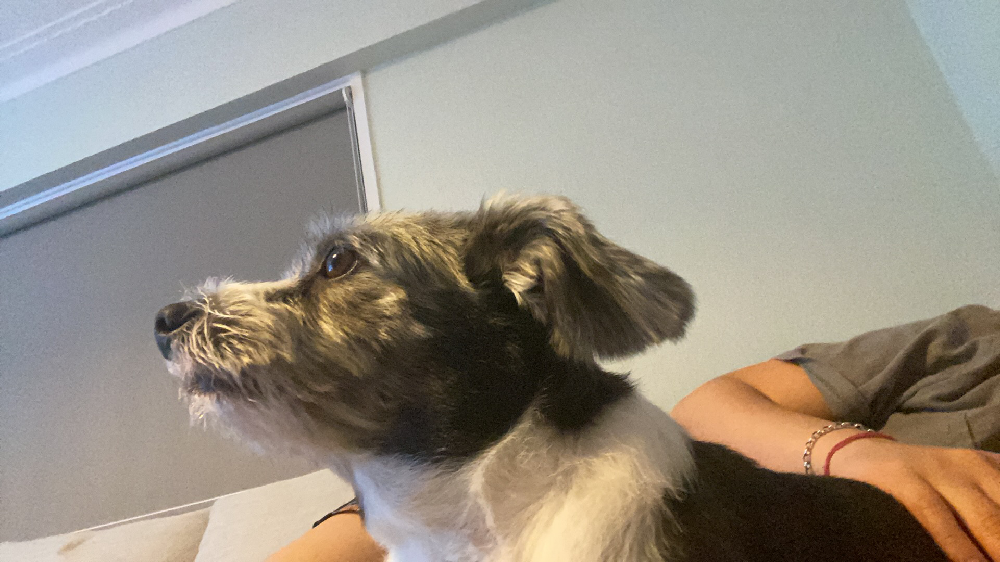

In [ ]:
Image(test_image_filename)

**NOTE: When batching, we need atleast 2 filenames. Becuase 1 filename has a shape of 0.**

Thus we are just passing a photo twice to avoid this error 

In [ ]:
# batch data
test_image_data = data_batching([test_image_filename,test_image_filename],test_data=True) 

Creating TEST data batches...


In [ ]:
# predict my dog niko
niko_predict = full_model.predict(test_image_data)

In [ ]:
#check label
get_pred_label(niko_predict[0])

'lakeland_terrier'

In [ ]:
# check top 5 predictions
unique_breeds[niko_predict[0].argsort()[-5:][::-1]]

array(['lakeland_terrier', 'norfolk_terrier', 'tibetan_terrier',
       'irish_terrier', 'border_terrier'], dtype=object)

In [ ]:
# check confidence for top 5
niko_predict[0][niko_predict[0].argsort()[-5:][::-1]]

array([0.2510266 , 0.19290666, 0.18385616, 0.10146391, 0.06774655],
      dtype=float32)

Wasnt a good prediction😓. Niko is a mix so thats why it dosent fit into breeds

Predicted label:lakeland_terrier at confidence: 25.10%


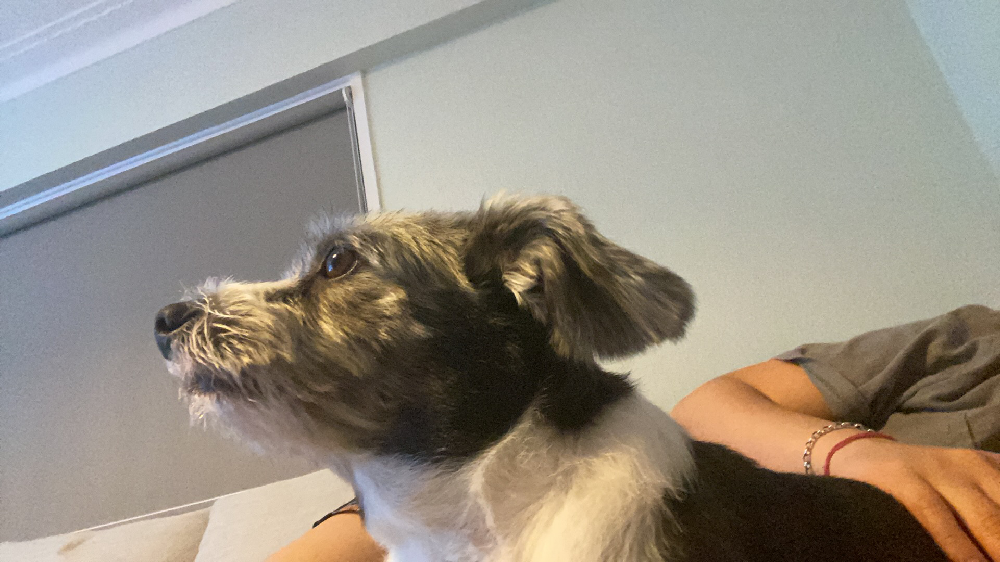

In [ ]:
compare_pred(niko_predict,test_image_filename,n=0)

Try another of my cousins dog buzz - he is a toy poodle

In [ ]:
# get filenames 
buzz_filenames = ["/content/drive/MyDrive/buzz1.jpg","/content/drive/MyDrive/buzz2.jpg"]
# batch the data 
buzz_data = data_batching(buzz_filenames,test_data=True)
# predict using model 
buzz_preds = full_model.predict(buzz_data)


Creating TEST data batches...


Predicted label:toy_poodle at confidence: 69.37%


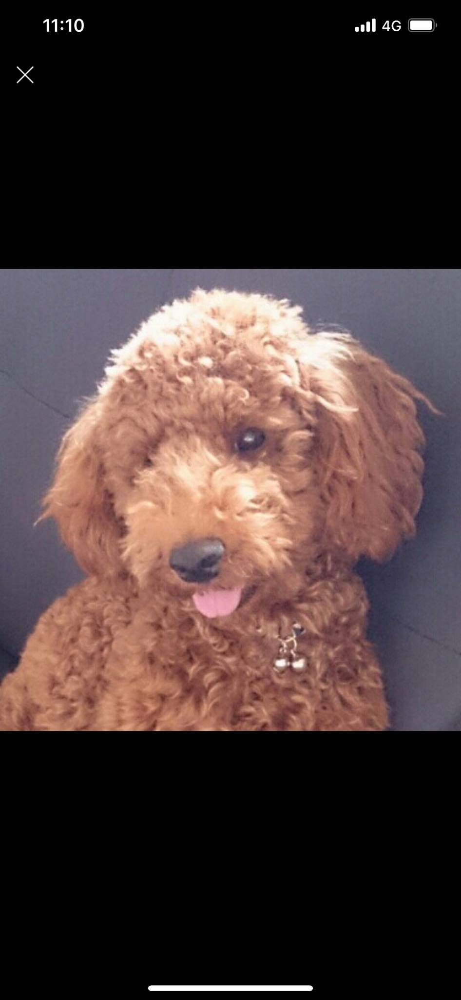

In [ ]:
# check if they were both correct 
compare_pred(buzz_preds,buzz_filenames,n=0)

Predicted label:bedlington_terrier at confidence: 51.17%


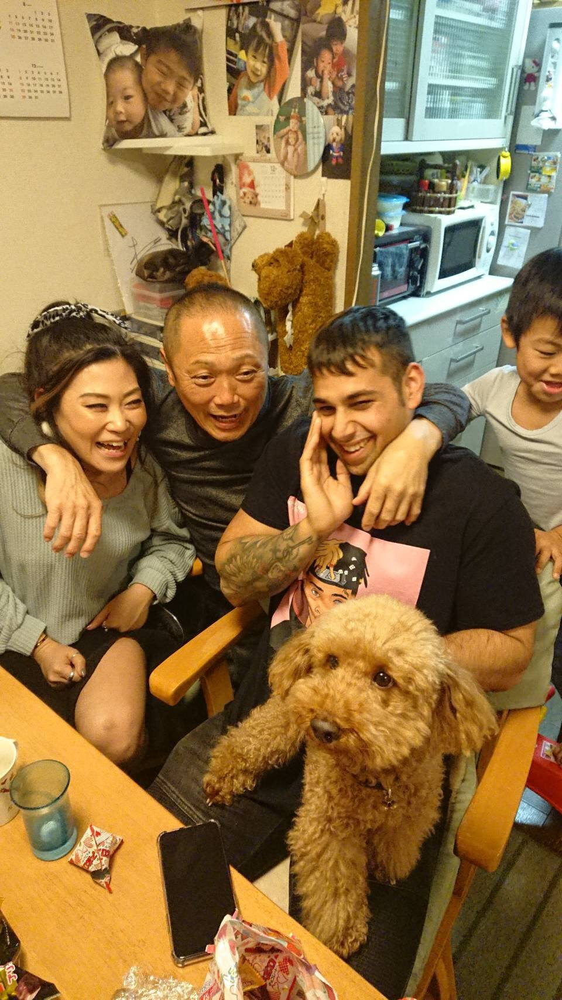

In [ ]:
compare_pred(buzz_preds,buzz_filenames,n=1)

First one correct 🥳 but second one was wrong.

The second one is harder to predict beacuse it has so many other things and people in the photo.

In [ ]:
# check second predictions!! Still prett good as there are poodles and the bellington_terrier looks simialar too
unique_breeds[buzz_preds[1].argsort()[-5:][::-1]]

array(['bedlington_terrier', 'standard_poodle', 'miniature_poodle',
       'toy_poodle', 'chow'], dtype=object)